In [0]:
# GLOBAL parameters
# first run of notebook
first_run=True

In [2]:
if first_run==True:
  !pip install numpy scipy
#   !pip install resampy tensorflow six
#   !pip install pysoundfile 
#   #from mp3 to wav
#   !pip install pydub



In [0]:
if first_run==True:
  import os
  import numpy as np
  from sklearn.manifold import TSNE


In [0]:
if first_run==True:
  from google.colab import auth
  auth.authenticate_user()


In [11]:
!gsutil cp gs://deep_learning_enis/speech_audio_understanding/embeddings2.npy ./
!gsutil cp gs://deep_learning_enis/speech_audio_understanding/postprocessed2.npy ./
!gsutil cp gs://deep_learning_enis/speech_audio_understanding/data_file_indexes2.npy ./


Copying gs://deep_learning_enis/speech_audio_understanding/embeddings2.npy...
\ [1 files][ 46.9 MiB/ 46.9 MiB]                                                
Operation completed over 1 objects/46.9 MiB.                                     
Copying gs://deep_learning_enis/speech_audio_understanding/postprocessed2.npy...
\ [1 files][ 46.9 MiB/ 46.9 MiB]                                                
Operation completed over 1 objects/46.9 MiB.                                     
Copying gs://deep_learning_enis/speech_audio_understanding/data_file_indexes2.npy...
/ [1 files][973.2 KiB/973.2 KiB]                                                
Operation completed over 1 objects/973.2 KiB.                                    


In [0]:
# !gsutil cp gs://deep_learning_enis/speech_audio_understanding/data.tar.gz ./

# !tar xzf data.tar.gz

mp3_data_files=os.listdir("./data/split_00:10/")

error_file=mp3_data_files.index("._FSHCK1_20160726_190204_1440m_00s__1500m_00s_52m_00s__54m_00s_00m_20s__00m_30s.mp3")

del mp3_data_files[error_file]


In [0]:
embeddings=np.load('embeddings2.npy')
postprocessed=np.load('postprocessed2.npy')
data_file_indexes=np.load('data_file_indexes2.npy')
#get dict from numpy array
data_file_indexes=data_file_indexes[()]

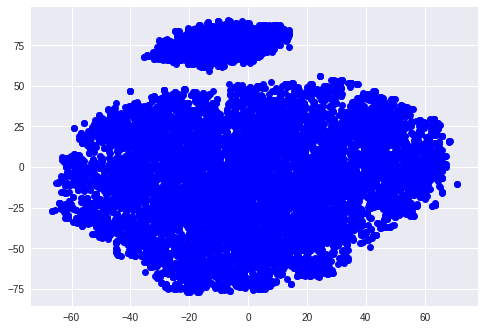

In [83]:

postprocessed=np.mean(postprocessed.reshape(10,-1,128),axis=0)
postprocessed_TSNE = TSNE(n_components=2).fit_transform(postprocessed)
plt.plot(postprocessed_TSNE[:,0],postprocessed_TSNE[:,1],'bo')

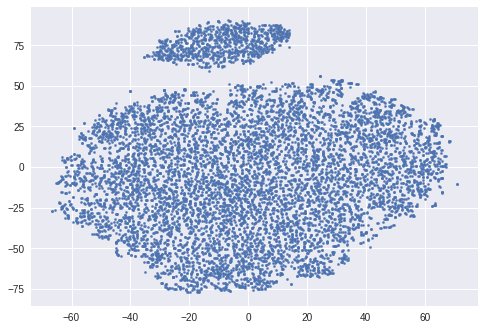

In [97]:
plt.scatter(postprocessed_TSNE[:,0],postprocessed_TSNE[:,1],s=5)

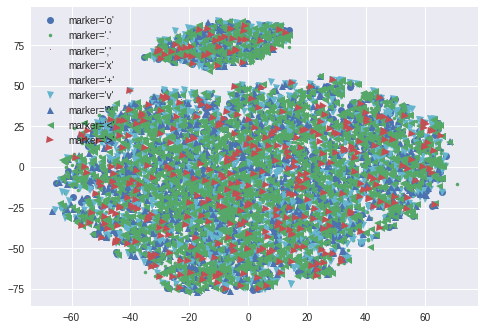

In [117]:
# rng = np.random.RandomState(0)
markers=['o', '.', ',', 'x', '+', 'v', '^', '<', '>', 's', 'd']
marker_dict={}
data_dict={}
site_names_set=set(site_names)

for i,site_name in enumerate(site_names_set):
  marker_dict[site_name]=markers[i] 
  data_dict[site_name]=[[],[]]

for i,site_name in enumerate(site_names):
  data_dict[site_name][0].append(postprocessed_TSNE[i,0])
  data_dict[site_name][1].append(postprocessed_TSNE[i,1])

for site_name in data_dict.keys():
  plt.plot(data_dict[site_name][0], data_dict[site_name][1], marker_dict[site_name],
    label="marker='{0}'".format(marker_dict[site_name]))

plt.legend(numpoints=1)
# plt.ylim(50, 100);


In [105]:
len(markers)

11

In [0]:
embeddings_avg=np.mean(embeddings.reshape(10,-1,128),axis=0)

In [0]:
for key,(start,end) in data_file_indexes.items():
  if end-start!=10:
    print("CAUTION ",key," had more or less than 10 seconds ",end,start)

In [37]:
embeddings_avg_TSNE = TSNE(n_components=2).fit_transform(embeddings_avg)
print(embeddings_avg_TSNE.shape)

(9600, 2)


In [0]:
import matplotlib.pyplot as plt


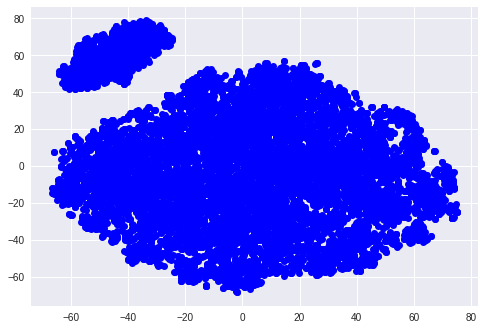

In [47]:
plt.plot(embeddings_avg_TSNE[:,0],embeddings_avg_TSNE[:,1],'bo')

In [0]:
import plotly
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode
plotly.offline.init_notebook_mode(connected=True)


In [0]:
site_names=[]
for name in mp3_data_files:
  file_id=name
  name=name.split("_")
#   if len(name)!=18:
#     print(name)
  site_name=name[0]
  site_names.append(site_name)
  date=name[1]
  year=date[0:4]
  month=date[4:6]
  day=date[6:8]
  
  site_id=name[2]

In [62]:
for i in range(len(site_names)):
trace = go.Scatter(
    x = embeddings_avg_TSNE[i,0],
    y = embeddings_avg_TSNE[i,1],
    mode = 'markers'
    marker=(text=site_names[i])
)

data = [trace]

# Plot and embed in ipython notebook!
py.iplot(data, filename='basic-scatter')


IndentationError: ignored

In [0]:
l= []
y= []
#data= pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/2014_usa_states.csv")
# Setting colors for plot.
# N= 53
# c= ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, N)]

for i in range(len(site_names)):
    trace0= go.Scatter(
        x = (embeddings_avg_TSNE[i,0],),
        y = (embeddings_avg_TSNE[i,1],),
        mode= 'markers',
#         marker= dict(size= 14,
#                     line= dict(width=1),
#                     opacity= 0.3
#                    ),
        text= site_names[i]) # The hover text goes here... 
    l.append(trace0);

In [76]:
fig= go.Figure(data=l)
plotly.offline.plot(fig)

'file:///content/temp-plot.html'

In [118]:
import IPython.display as ipd
ipd.Audio('./data/split_00:10/UMIAT_20130725_210243_1200m_00s__1260m_00s_40m_00s__42m_00s_01m_30s__01m_40s.mp3')

In [128]:
import IPython

for i,name in enumerate(mp3_data_files):
  if embeddings_avg_TSNE[i,1]>70:
    IPython.display.display(ipd.Audio('./data/split_00:10/'+name))
    print('./data/split_00:10/'+name)
  

./data/split_00:10/ROCKY_20160610_223054_0000m_00s__0060m_00s_18m_00s__20m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/UMIAT_20130719_230628_1740m_00s__1800m_00s_12m_00s__14m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160809_011833_0780m_00s__0840m_00s_50m_00s__52m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_56m_00s__58m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_56m_00s__58m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/UMIAT_20130725_210243_1200m_00s__1260m_00s_40m_00s__42m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/ROCKY_20160623_083823_1080m_00s__1140m_00s_02m_00s__04m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/USGS_20160613_234225_1320m_00s__1380m_00s_32m_00s__34m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_1980m_00s__2040m_00s_32m_00s__34m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/UMIAT_20130719_230628_0240m_00s__0300m_00s_34m_00s__36m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1920m_00s__1980m_00s_50m_00s__52m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_0480m_00s__0540m_00s_22m_00s__24m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/ROCKY_20160621_065709_2400m_00s__2460m_00s_04m_00s__06m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/ROCKY_20160610_223054_0000m_00s__0060m_00s_44m_00s__46m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/ROCKY_20160621_065709_2400m_00s__2460m_00s_06m_00s__08m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/ROCKY_20160610_223054_0180m_00s__0240m_00s_18m_00s__20m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2940m_00s__2981m_09s_23h_02m_00s__04m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160701_010928_1020m_00s__1080m_00s_36m_00s__38m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/UMIRUK_20160617_051128_1920m_00s__1980m_00s_38m_00s__40m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/USGS_20160613_234225_2820m_00s__2880m_00s_34m_00s__36m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_14m_00s__16m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/OCNPT_20160809_011833_2820m_00s__2880m_00s_10m_00s__12m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_22m_00s__24m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_22m_00s__24m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_30m_00s__32m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2940m_00s__2981m_09s_23h_16m_00s__18m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1080m_00s__1140m_00s_36m_00s__38m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2940m_00s__2981m_09s_23h_12m_00s__14m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIAT_20130725_210243_2880m_00s__2940m_00s_24m_00s__26m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_10m_00s__12m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/OCNPT_20160701_010928_1920m_00s__1980m_00s_50m_00s__52m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2640m_00s__2700m_00s_10m_00s__12m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/USGS_20160613_234225_0900m_00s__0960m_00s_34m_00s__36m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130725_210243_1320m_00s__1380m_00s_40m_00s__42m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/ROCKY_20160621_065709_1860m_00s__1920m_00s_02m_00s__04m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/ROCKY_20160621_065709_0180m_00s__0240m_00s_28m_00s__30m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_32m_00s__34m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/ROCKY_20160621_065709_0180m_00s__0240m_00s_48m_00s__50m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_2820m_00s__2880m_00s_50m_00s__52m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130725_210243_2520m_00s__2580m_00s_40m_00s__42m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130719_230628_0240m_00s__0300m_00s_54m_00s__56m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130725_210243_2520m_00s__2580m_00s_38m_00s__40m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1920m_00s__1980m_00s_18m_00s__20m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/CLVL5_20160621_074419_0120m_00s__0180m_00s_08m_00s__10m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/ROCKY_20160621_065709_2400m_00s__2460m_00s_52m_00s__54m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_48m_00s__50m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1260m_00s__1320m_00s_06m_00s__08m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/USGS_20160613_234225_0900m_00s__0960m_00s_32m_00s__34m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/OCNPT_20160701_010928_1920m_00s__1980m_00s_32m_00s__34m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/ROCKY_20160610_223054_0000m_00s__0060m_00s_34m_00s__36m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1920m_00s__1980m_00s_58m_00s__60m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/ROCKY_20160610_223054_2280m_00s__2340m_00s_56m_00s__58m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/OCNPT_20160701_010928_1920m_00s__1980m_00s_16m_00s__18m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_16m_00s__18m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/UMIAT_20130725_210243_1200m_00s__1260m_00s_42m_00s__44m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/USGS_20160613_234225_1320m_00s__1380m_00s_30m_00s__32m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/ROCKY_20160621_065709_1860m_00s__1920m_00s_40m_00s__42m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_26m_00s__28m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_44m_00s__46m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/OCNPT_20160701_010928_1920m_00s__1980m_00s_30m_00s__32m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIAT_20130725_210243_2520m_00s__2580m_00s_06m_00s__08m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_1980m_00s__2040m_00s_26m_00s__28m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/OCNPT3_20160606_180548_2100m_00s__2160m_00s_18m_00s__20m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130719_230628_0480m_00s__0540m_00s_30m_00s__32m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_16m_00s__18m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/USGS_20160613_234225_2820m_00s__2880m_00s_56m_00s__58m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/ROCKY_20160610_223054_0840m_00s__0900m_00s_26m_00s__28m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/ROCKY_20160610_223054_0840m_00s__0900m_00s_44m_00s__46m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1920m_00s__1980m_00s_12m_00s__14m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/ROCKY_20160621_065709_2400m_00s__2460m_00s_52m_00s__54m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/ROCKY_20160621_065709_0480m_00s__0540m_00s_16m_00s__18m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/ROCKY_20160621_065709_2400m_00s__2460m_00s_50m_00s__52m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_06m_00s__08m_00s_01m_50s__01m_59s_92h.mp3


./data/split_00:10/OCNPT_20160701_010928_0180m_00s__0240m_00s_38m_00s__40m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/UMIAT_20130719_230628_0480m_00s__0540m_00s_18m_00s__20m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_38m_00s__40m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/UMIAT_20130725_210243_1320m_00s__1380m_00s_48m_00s__50m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/ROCKY_20160610_223054_0000m_00s__0060m_00s_46m_00s__48m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/ROCKY_20160621_065709_1620m_00s__1680m_00s_10m_00s__12m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130719_230628_1980m_00s__2040m_00s_48m_00s__50m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/OCNPT_20160809_011833_2220m_00s__2280m_00s_52m_00s__54m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1860m_00s__1920m_00s_36m_00s__38m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_18m_00s__20m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2880m_00s__2940m_00s_38m_00s__40m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_14m_00s__16m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_44m_00s__46m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1260m_00s__1320m_00s_20m_00s__22m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/FSHCK4_20160629_194935_2760m_00s__2820m_00s_36m_00s__38m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIAT_20130725_210243_1320m_00s__1380m_00s_44m_00s__46m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/ROCKY_20160621_065709_0180m_00s__0240m_00s_02m_00s__04m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130725_210243_1320m_00s__1380m_00s_46m_00s__48m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1920m_00s__1980m_00s_48m_00s__50m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_06m_00s__08m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/USGS_20160613_234225_1560m_00s__1620m_00s_52m_00s__54m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_12m_00s__14m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130725_210243_1080m_00s__1140m_00s_44m_00s__46m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2640m_00s__2700m_00s_18m_00s__20m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/USGS_20160613_234225_0000m_00s__0060m_00s_38m_00s__40m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_26m_00s__28m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1860m_00s__1920m_00s_14m_00s__16m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/UMIAT_20130719_230628_1740m_00s__1800m_00s_20m_00s__22m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_22m_00s__24m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/CLVL5_20160621_074419_0120m_00s__0180m_00s_10m_00s__12m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/OCNPT3_20160606_180548_2100m_00s__2160m_00s_26m_00s__28m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130725_210243_1200m_00s__1260m_00s_16m_00s__18m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_36m_00s__38m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130725_210243_1200m_00s__1260m_00s_46m_00s__48m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/ROCKY_20160621_065709_0180m_00s__0240m_00s_48m_00s__50m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1920m_00s__1980m_00s_36m_00s__38m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/ROCKY_20160621_065709_0180m_00s__0240m_00s_52m_00s__54m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/ROCKY_20160610_223054_1920m_00s__1980m_00s_46m_00s__48m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1740m_00s__1800m_00s_54m_00s__56m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1740m_00s__1800m_00s_44m_00s__46m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1080m_00s__1140m_00s_16m_00s__18m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/ROCKY_20160610_223054_0840m_00s__0900m_00s_38m_00s__40m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK4_20160629_194935_2760m_00s__2820m_00s_44m_00s__46m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1260m_00s__1320m_00s_30m_00s__32m_00s_01m_50s__01m_59s_90h.mp3


./data/split_00:10/ROCKY_20160610_223054_2280m_00s__2340m_00s_32m_00s__34m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/OCNPT_20160809_011833_2220m_00s__2280m_00s_52m_00s__54m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/OCNPT_20160701_010928_2580m_00s__2640m_00s_30m_00s__32m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_18m_00s__20m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_04m_00s__06m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130719_230628_1980m_00s__2040m_00s_48m_00s__50m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/ROCKY_20160610_223054_0180m_00s__0240m_00s_42m_00s__44m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/OCNPT_20160809_011833_2520m_00s__2580m_00s_04m_00s__06m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/UMIRUK_20160617_051128_0180m_00s__0240m_00s_04m_00s__06m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1920m_00s__1980m_00s_38m_00s__40m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/CLVL5_20160621_074419_2400m_00s__2460m_00s_20m_00s__22m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1920m_00s__1980m_00s_12m_00s__14m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160701_010928_2580m_00s__2640m_00s_46m_00s__48m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130725_210243_0780m_00s__0840m_00s_30m_00s__32m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160809_011833_0780m_00s__0840m_00s_02m_00s__04m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1920m_00s__1980m_00s_30m_00s__32m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/ROCKY_20160610_223054_0840m_00s__0900m_00s_42m_00s__44m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/OCNPT_20160809_011833_2820m_00s__2880m_00s_40m_00s__42m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIAT_20130719_230628_1740m_00s__1800m_00s_16m_00s__18m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/OCNPT_20160809_011833_2520m_00s__2580m_00s_44m_00s__46m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/OCNPT_20160809_011833_0780m_00s__0840m_00s_22m_00s__24m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/UMIAT_20130719_230628_0480m_00s__0540m_00s_16m_00s__18m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_54m_00s__56m_00s_01m_50s__01m_59s_90h.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_32m_00s__34m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/FSHCK4_20160629_194935_1140m_00s__1200m_00s_08m_00s__10m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIAT_20130725_210243_2880m_00s__2940m_00s_34m_00s__36m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1440m_00s__1500m_00s_32m_00s__34m_00s_01m_30s__01m_40s.mp3


./data/split_00:10/OCNPT_20160809_011833_2520m_00s__2580m_00s_44m_00s__46m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/UMIAT_20130725_210243_2820m_00s__2880m_00s_42m_00s__44m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/ROCKY_20160621_065709_0480m_00s__0540m_00s_42m_00s__44m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/USGS_20160613_234225_0660m_00s__0720m_00s_12m_00s__14m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/UMIAT_20130823_015059_1380m_00s__1440m_00s_28m_00s__30m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1440m_00s__1500m_00s_50m_00s__52m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_18m_00s__20m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/OCNPT3_20160606_180548_2820m_00s__2880m_00s_30m_00s__32m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/USGS_20160613_234225_1560m_00s__1620m_00s_20m_00s__22m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160809_011833_1380m_00s__1440m_00s_12m_00s__14m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/OCNPT_20160809_011833_2520m_00s__2580m_00s_04m_00s__06m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIAT_20130823_015059_0780m_00s__0840m_00s_40m_00s__42m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/USGS_20160613_234225_2820m_00s__2880m_00s_26m_00s__28m_00s_01m_40s__01m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_1980m_00s__2040m_00s_42m_00s__44m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/OCNPT_20160701_010928_1020m_00s__1080m_00s_20m_00s__22m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/UMIAT_20130719_230628_0240m_00s__0300m_00s_34m_00s__36m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/ROCKY_20160621_065709_1620m_00s__1680m_00s_32m_00s__34m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/USGS_20160613_234225_0900m_00s__0960m_00s_18m_00s__20m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/FSHCK1_20160726_190204_1080m_00s__1140m_00s_28m_00s__30m_00s_00m_10s__00m_20s.mp3


./data/split_00:10/ROCKY_20160623_083823_1080m_00s__1140m_00s_08m_00s__10m_00s_01m_10s__01m_20s.mp3


./data/split_00:10/OCNPT_20160701_010928_2220m_00s__2280m_00s_26m_00s__28m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/USGS_20160613_234225_0900m_00s__0960m_00s_04m_00s__06m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/FSHCK1_20160726_190204_1440m_00s__1500m_00s_08m_00s__10m_00s_00m_50s__01m_00s.mp3


./data/split_00:10/UMIAT_20130719_230628_1740m_00s__1800m_00s_50m_00s__52m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/USGS_20160613_234225_0000m_00s__0060m_00s_06m_00s__08m_00s_00m_20s__00m_30s.mp3


./data/split_00:10/FSHCK4_20160629_194935_2220m_00s__2280m_00s_18m_00s__20m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/UMIRUK_20160617_051128_2340m_00s__2400m_00s_56m_00s__58m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/UMIAT_20130719_230628_0480m_00s__0540m_00s_28m_00s__30m_00s_01m_00s__01m_10s.mp3


./data/split_00:10/OCNPT3_20160606_180548_1980m_00s__2040m_00s_16m_00s__18m_00s_00m_00s__00m_10s.mp3


./data/split_00:10/OCNPT_20160809_011833_0240m_00s__0300m_00s_30m_00s__32m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/USGS_20160613_234225_0000m_00s__0060m_00s_28m_00s__30m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/FSHCK1_20160726_190204_1440m_00s__1500m_00s_26m_00s__28m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/OCNPT_20160809_011833_2220m_00s__2280m_00s_14m_00s__16m_00s_01m_20s__01m_30s.mp3


./data/split_00:10/OCNPT_20160809_011833_2820m_00s__2880m_00s_30m_00s__32m_00s_00m_40s__00m_50s.mp3


./data/split_00:10/ROCKY_20160610_223054_0180m_00s__0240m_00s_46m_00s__48m_00s_00m_30s__00m_40s.mp3


./data/split_00:10/UMIRUK_20160617_051128_1920m_00s__1980m_00s_12m_00s__14m_00s_01m_50s__01m_59s_95h.mp3


./data/split_00:10/UMIRUK_20160617_051128_2640m_00s__2700m_00s_28m_00s__30m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/UMIRUK_20160617_051128_1260m_00s__1320m_00s_06m_00s__08m_00s_01m_50s__01m_59s_98h.mp3


./data/split_00:10/ROCKY_20160610_223054_0180m_00s__0240m_00s_38m_00s__40m_00s_00m_10s__00m_20s.mp3
